In [ ]:
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/seminar.py
!mkdir resources
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/01-simple-train.jpg -O resources/01-simple-train.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/02-batchnorm.jpg -O resources/02-batchnorm.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/03-overfit.jpg -O resources/03-overfit.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/04-l2.jpg -O resources/04-l2.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/05-dropout.jpg -O resources/05-dropout.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/06-batchnorm.jpg -O resources/06-batchnorm.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/07-aug-affine.jpg -O resources/07-aug-affine.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/07-aug-all.jpg -O resources/07-aug-all.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/08-aug-all.jpg -O resources/08-aug-all.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/09-aug-album.jpg -O resources/09-aug-album.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/aug-00-affine.jpg -O resources/aug-00-affine.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/aug-01-crop.jpg -O resources/aug-01-crop.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/aug-02-color.jpg -O resources/aug-02-color.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/aug-03-blur.jpg -O resources/aug-03-blur.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/aug-04-random.jpg -O resources/aug-04-random.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/batchnorm.jpg -O resources/batchnorm.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/made.jpg -O resources/made.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/vgg1.jpg -O resources/vgg1.jpg
!wget https://raw.githubusercontent.com/lysukhin/MADE/2022/computer_vision/seminar01_opencv_augment/resources/vgg2.jpg -O resources/vgg2.jpg


<img style="float: left;" src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/made.jpg?raw=1" width="25%" height="25%">

# Академия MADE
## Семинар 1: PyTorch recap / аугментация / OpenCV
  
Иван Карпухин

<div style="clear:both;"></div>

Семинар состоит из двух частей. В первой мы применим классические методы регуляризации. Во второй сделаем аугментацию данных средствами OpenCV.

Для выполнения работы нужны следующие пакеты (Python 3):
* opencv-python
* torch
* torchvision
* albumentations

Установить их можно командой:
```bash
pip3 install --user opencv-python torch torchvision albumentations
```

In [ ]:
!pip install pytorch_lightning

In [12]:
import random

import albumentations
import cv2
import torch
import torchvision
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import pytorch_lightning as pl

import seminar

print(torch.__version__)

# Параметры тренировки.
USE_CUDA = torch.cuda.is_available()
if USE_CUDA:
    print("Use CUDA")


TRAIN = True

TRAIN_KWARGS = {"use_cuda": USE_CUDA}

1.8.0+cpu


# Простая тренировка на CIFAR-10.

## Подготовка данных

Если возникнут трудности при загрузке данных, можно скачать архив по ссылке и самостоятельно распаковать в папку с ноутбуком, так, чтобы рядом с ноутбуком появилась папка cifar-10-batches-py.

Ссылка с данными (если не заработает автоскачивание): https://cloud.mail.ru/public/2ku1/KJPEsJ6xR

Files already downloaded and verified
Files already downloaded and verified
Single image shape (CHW): [3, 32, 32]
Trainset size: 50000
Testset size: 10000
Trainset


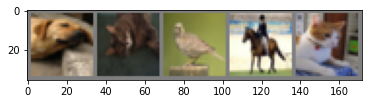

Testset


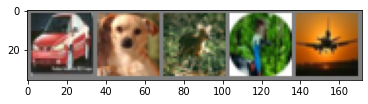

In [13]:
from torchvision.datasets import CIFAR10

DATA_ROOT = "."

transform = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),  # Преобразовать PIL изображения в Torch тензоры.
    torchvision.transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])
trainset = CIFAR10(DATA_ROOT, train=True, download=True, transform=transform)
testset = CIFAR10(DATA_ROOT, train=False, download=True, transform=transform)

# testset[0] - tuple(features, class)
print("Single image shape (CHW):", list(testset[0][0].shape))
print("Trainset size:", len(trainset))
print("Testset size:", len(testset))

print("Trainset")
seminar.show_images_dataset(trainset)
print("Testset")
seminar.show_images_dataset(testset)

## Создание модели

Создадим сеть вида VGG (Сокращение от Visual Geometry Group, https://arxiv.org/pdf/1409.1556.pdf ).

Сеть VGG состоит из сверток 3x3, ReLU, max pooling и полносвязных слоев. Оригинальная сеть VGG применялась к изображениям 224x224, мы же применяем к изображениям 32x32. В статье описаны варианты сети VGG с количеством слоев от 11 до 19. Для задачи CIFAR10 достаточно меньшего числа слоев. Итоговая сложность модели позволит нам учить сеть на CPU.

Заметьте, что после pooling слоя площадь изображения уменьшается в 4 раза, а число каналов увеличивается в два раза, т.е. размер тензора уменьшается в два раза. Баланс между размером изображения и числом каналов позволяет сохранить достаточное количество информации при продвижении по сети.

<img src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/vgg1.jpg?raw=1" align="left" hspace="20" width="50%" height="50%"/> 
<img src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/vgg2.jpg?raw=1" align="left" hspace="20" width="50%" height="50%"/>
<div style="clear:both;"></div>

Шпаргалка:

```python
torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros')

torch.nn.ReLU(inplace=False)

torch.nn.MaxPool2d(kernel_size, stride=None, padding=0, dilation=1, return_indices=False, ceil_mode=False)

torch.nn.Linear(in_features, out_features, bias=True)
```

In [14]:
class VGGNetwork(torch.nn.Sequential):        
    def _make_conv3x3(self, in_channels, out_channels):
        # Начало вашего кода.
        
        layer = torch.nn.Conv2d(in_channels, out_channels, 3, padding=1)
        
        # Конец вашего кода.
        return layer
    
    def _make_relu(self):
        # Начало вашего кода.
        
        layer = torch.nn.ReLU()
        
        # Конец вашего кода.
        return layer
    
    def _make_maxpool2x2(self):
        # Начало вашего кода.
        
        layer = torch.nn.MaxPool2d(2)
        
        # Конец вашего кода.
        return layer
    
    def _make_fully_connected(self, in_features, out_features, last=False):
        # Начало вашего кода.
        
        layer = torch.nn.Linear(in_features, out_features)
        
        # Конец вашего кода.
        return layer
    
    def __init__(self, n_classes=10):
        # Мы используем same padding, чтобы свертки не меняли ширину и высоту тензоров.
        # Ширина и высота меняются только в maxpool (уменьшаются в два раза).
        layers = [
            self._make_conv3x3(in_channels=3, out_channels=32),
            self._make_relu(),
            self._make_conv3x3(in_channels=32, out_channels=32),
            self._make_relu(),
            self._make_maxpool2x2(),
            
            self._make_conv3x3(in_channels=32, out_channels=64),
            self._make_relu(),
            self._make_conv3x3(in_channels=64, out_channels=64),
            self._make_relu(),
            self._make_maxpool2x2(),
            
            self._make_conv3x3(in_channels=64, out_channels=128),
            self._make_relu(),
            self._make_conv3x3(in_channels=128, out_channels=128),
            self._make_relu(),
            self._make_maxpool2x2(),
            
            self._make_conv3x3(in_channels=128, out_channels=256),
            self._make_relu(),
            self._make_conv3x3(in_channels=256, out_channels=256),
            self._make_relu(),
            self._make_maxpool2x2(),
            
            torch.nn.modules.Flatten(),  # Преобразовать 4-мерный тензор BHWC в двумерный BD.
            
            self._make_fully_connected(in_features=256 * 2 * 2, out_features=512),
            self._make_fully_connected(in_features=512, out_features=512),
            self._make_fully_connected(in_features=512, out_features=n_classes, last=True)
        ]
        super().__init__(*layers)
        self.initialize_weights()
    
    def initialize_weights(self):
        for m in self.modules():
            if isinstance(m, torch.nn.Conv2d):
                torch.nn.init.kaiming_normal_(m.weight, mode="fan_out", nonlinearity="relu")
                if m.bias is not None:
                    torch.nn.init.constant_(m.bias, 0)
            elif isinstance(m, torch.nn.BatchNorm2d):
                torch.nn.init.constant_(m.weight, 1)
                torch.nn.init.constant_(m.bias, 0)
            elif isinstance(m, torch.nn.Linear):
                torch.nn.init.normal_(m.weight, 0, 0.01)
                torch.nn.init.constant_(m.bias, 0)
                
def count_parameters(model):
    total = 0
    for p in model.parameters():
        total += np.prod(list(p.shape))
    return total
                
vgg = VGGNetwork()
print(vgg)
print("Total parameters: {}".format(count_parameters(vgg)))

seminar.check_vgg(VGGNetwork)

VGGNetwork(
  (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU()
  (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU()
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU()
  (7): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU()
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU()
  (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU()
  (14): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (15): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (16): ReLU()
  (17): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (18): ReLU()
  (19): MaxPool2d(kernel_size=2

## Обучение

Воспользуемся оптимизацией с моментом Нестерова. Будем использовать момент, равный 0.9 и начальный шаг обучения 0.01.

Шпаргалка:

```python
torch.nn.CrossEntropyLoss(weight=None, size_average=None, ignore_index=-100, reduce=None, reduction='mean')

torch.optim.SGD(params, lr, momentum=0, dampening=0, weight_decay=0, nesterov=False)
```

In [15]:
def make_loss():
    # Ваш код, который создает loss.
    
    loss = torch.nn.CrossEntropyLoss()
    
    #
    return loss

def make_optimizer(model):
    # Ваш код, который создает оптимизатор.
    
    optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.9, nesterov=True)
    
    # Конец вашего кода.
    
    return optimizer

seminar.check_loss_fn(make_loss)
seminar.check_optimizer_fn(make_optimizer)

CHECK OK
CHECK OK


Используем экспоненциально затухающий learning rate.

График изменения learning rate:


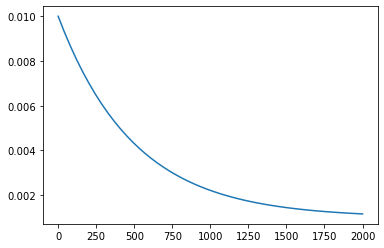

In [16]:
def lr(step):
    return 0.1 + 0.9 * (0.998) ** step

def make_lr_scheduler(optimizer):
    return torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr)

xs = np.linspace(0, 2000)
print("График изменения learning rate:")
plt.plot(xs, 0.01 * lr(xs))
plt.show()

In [17]:
class Module(pl.LightningModule):
    def __init__(self, model, loss_fn, optimizer_fn, trainset, testset,
                 lr_scheduler_fn=None,
                 batch_size=16):
        super().__init__()
        self._model = model
        self._optimizer_fn = optimizer_fn
        self._lr_scheduler_fn = lr_scheduler_fn
        self._criterion = loss_fn()
        self._batch_size = batch_size
        self._trainset = trainset
        self._testset = testset
        
    def forward(self, input):
        return self._model(input)
    
    def training_step(self, batch, batch_idx):
        # training_step defines the train loop. It is independent of forward
        x, y = batch
        logits = self._model(x)
        loss = self._criterion(logits, y)
        self.logger.experiment.add_scalars("loss", 
                                           {"train": loss}, 
                                           global_step=self.global_step)
        self.logger.experiment.add_scalars("accuracy", 
                                           {"train": self._accuarcy(logits, y)}, 
                                           global_step=self.global_step)
        return loss
    
    def validation_step(self, batch, batch_idx):
        x, y = batch
        logits = self._model(x)
        loss = self._criterion(logits, y)
        self.logger.experiment.add_scalars("loss", 
                                           {"val": loss}, 
                                           global_step=self.global_step)
        self.logger.experiment.add_scalars("accuracy", 
                                           {"val": self._accuarcy(logits, y)}, 
                                           global_step=self.global_step)
        
    def train_dataloader(self):
        return torch.utils.data.DataLoader(self._trainset, batch_size=self._batch_size, shuffle=True, drop_last=True)
    
    def val_dataloader(self):
        return torch.utils.data.DataLoader(self._testset, batch_size=self._batch_size, shuffle=False)

    def configure_optimizers(self):
        optimizer = self._optimizer_fn(self._model)
        scheduler = self._lr_scheduler_fn(optimizer)
        return [optimizer], [scheduler]
    
    def _accuarcy(self, logits, labels):
        predictions = logits.argmax(-1)
        return (predictions == labels).float().mean()
    
    
def train_model(model, loss_fn, optimizer_fn, trainset, testset,
                lr_scheduler_fn=None,
                batch_size=16,
                eval_steps=250,
                num_epochs=1,
                use_cuda=False):
    model = Module(model, loss_fn, optimizer_fn, trainset, testset,
                   lr_scheduler_fn, batch_size)
    trainer = pl.Trainer(gpus=int(use_cuda), max_epochs=num_epochs, val_check_interval=eval_steps)
    trainer.fit(model)

In [ ]:
train_model(vgg, make_loss, make_optimizer, trainset, testset,
            lr_scheduler_fn=make_lr_scheduler,
            **TRAIN_KWARGS)

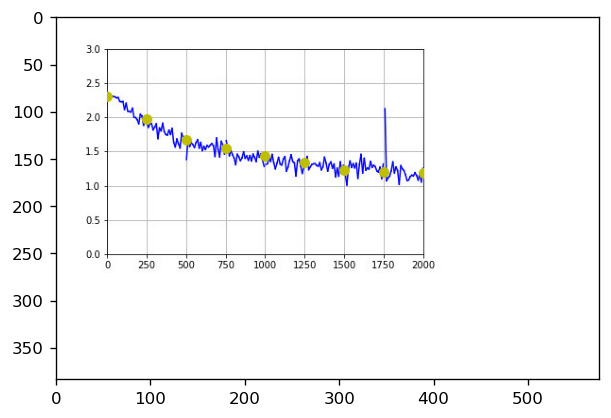

In [18]:
if True:
    seminar.show_image("resources/01-simple-train.jpg")

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir lightning_logs

# Batchnorm

Batchnorm ( https://arxiv.org/pdf/1502.03167.pdf ) это техника улучшения сходимости сетей с большим количеством слоёв.

Во время тренировки:

<img src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/batchnorm.jpg?raw=1" align="left" width="40%" height="40%"/> 
<div style="clear:both;"></div>

Во время применения статистики по батчу заменяются на более точные статистики по корпусу данных.

Шпаргалка:

```python
torch.nn.BatchNorm2d(num_features, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
```

In [19]:
class VGGNetworkBN(VGGNetwork):
    @staticmethod
    def _make_conv3x3(in_channels, out_channels):
        # Ваш код, который создает слои сети.
        
        conv_layer = torch.nn.Conv2d(in_channels, out_channels, 3, padding=1, bias=False)
        batchnorm_layer = torch.nn.BatchNorm2d(out_channels)
        
        # Конец вашего кода.
        return torch.nn.Sequential(conv_layer, batchnorm_layer)
    
vgg_bn = VGGNetworkBN()
print(vgg_bn)
seminar.check_vgg_bn(VGGNetworkBN)

VGGNetworkBN(
  (0): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (1): ReLU()
  (2): Sequential(
    (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (3): ReLU()
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (6): ReLU()
  (7): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (8): ReLU()
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, 

In [ ]:
train_model(vgg_bn, make_loss, make_optimizer, trainset, testset,
            lr_scheduler_fn=make_lr_scheduler,
            **TRAIN_KWARGS)

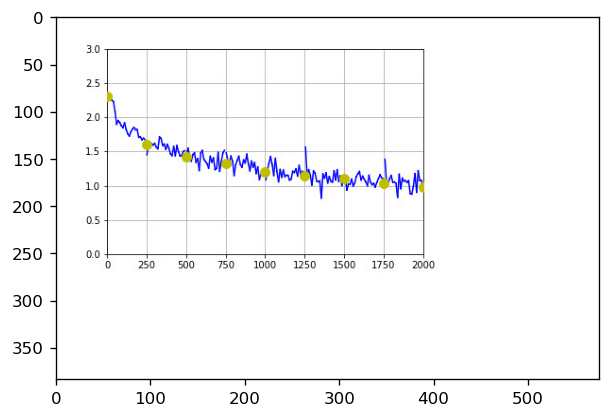

In [20]:
if True:
    seminar.show_image("resources/02-batchnorm.jpg")

In [ ]:
%tensorboard --logdir lightning_logs

# Переобучение

Из соображений производительности, мы используем небольшую сеть. На CIFAR10 она не переобучается. Чтобы воспроизвести ситуацию с переобучением, мы уменьшим количество тренировочных данных.

In [21]:
TRAIN_SUBSET_SIZE = 5000

trainset_small_indices = random.sample(list(range(len(trainset))), TRAIN_SUBSET_SIZE)
trainset_small = torch.utils.data.Subset(trainset, trainset_small_indices)
print("Small trainset size:", len(trainset_small))

Small trainset size: 5000


In [ ]:
train_model(vgg, make_loss, make_optimizer, trainset_small, testset,
            lr_scheduler_fn=make_lr_scheduler,
            num_epochs=10,
            **TRAIN_KWARGS)

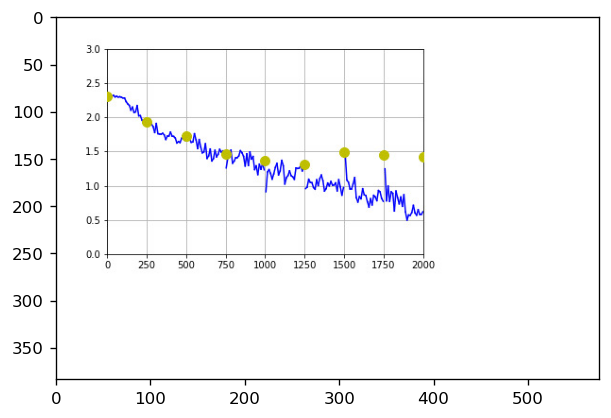

In [22]:
if True:
    seminar.show_image("resources/03-overfit.jpg")

In [ ]:
%tensorboard --logdir lightning_logs

## L2 - регуляризация (Тихонова)

К функции потерь добавляется сумма квадратов параметров модели с некотрым весом (weight decay). В итоге модель штрафуется за слишком большие веса модели. Ограничение на диапазон значений параметров приводит к уменьшению переобучения.

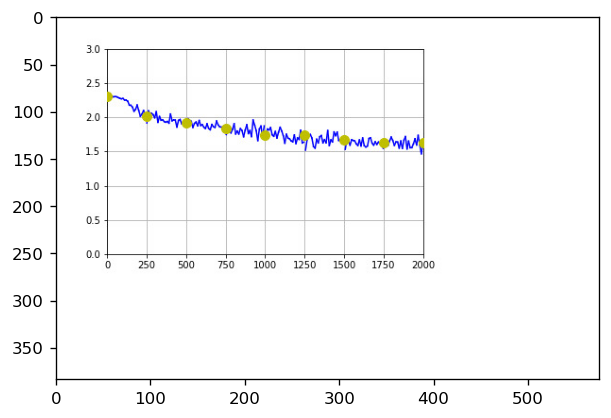

In [23]:
WEIGHT_DECAY = 0.01

def make_optimizer_l2_reg(model):
    return torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.9, nesterov=True, weight_decay=WEIGHT_DECAY)

# train_model(vgg, make_loss, make_optimizer_l2_reg, trainset_small, testset,
#             lr_scheduler_fn=make_lr_scheduler,
#             num_epochs=10,
#             **TRAIN_KWARGS)
if True:
    seminar.show_image("resources/04-l2.jpg")

# Dropout

Свертки содержат мало параметров, они не переобучаются. По-этому, dropout обычно используют в полносвязных слоях.

In [24]:
class VGGNetworkDO(VGGNetwork):
    @staticmethod
    def _make_fully_connected(in_features, out_features, last=False):
        layers = [torch.nn.Linear(in_features, out_features)]
        if not last:
            layers.append(torch.nn.Dropout(p=0.85))
        return torch.nn.Sequential(*layers)
    
vgg_do = VGGNetworkDO()
print(vgg_do)
seminar.check_vgg_do(VGGNetworkDO)

VGGNetworkDO(
  (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU()
  (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU()
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU()
  (7): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU()
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU()
  (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU()
  (14): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (15): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (16): ReLU()
  (17): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (18): ReLU()
  (19): MaxPool2d(kernel_size

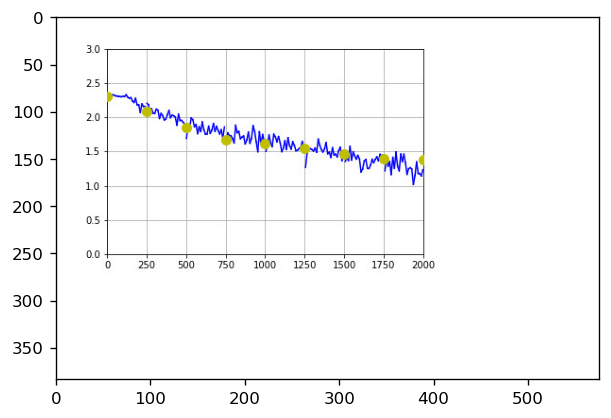

In [25]:
# train_model(vgg_do, make_loss, make_optimizer, trainset_small, testset,
#             lr_scheduler_fn=make_lr_scheduler,
#             num_epochs=10,
#             **TRAIN_KWARGS)
if True:
    seminar.show_image("resources/05-dropout.jpg")

## Аугментация

Мы используем следующие аугментации:
1. Rotation / Scale / Offset
2. Random crop
3. Brightness / Contrast
4. Blur

Шпаргалка:
```python
cv2.getRotationMatrix2D(center, angle, scale)  # center: (x, y), angle: градусы, scale: число.

cv2.warpAffine(src, M, dsize[, dst[, flags[, borderMode[, borderValue]]]])
```

In [30]:
import math
angle = np.pi/4
rotate = np.array([[math.cos(angle), -math.sin(angle)],
                  [math.sin(angle),  math.cos(angle)]])
vector_x = np.array([1, 0])
vector_y = np.array([0, 1])
rotate_x_vector = rotate @ vector_x
rotate_y_vector = rotate @ vector_y
print(rotate_x_vector)
print(rotate_y_vector)

[0.70710678 0.70710678]
[-0.70710678  0.70710678]


In [31]:
print(rotate)

[[ 0.70710678 -0.70710678]
 [ 0.70710678  0.70710678]]


In [ ]:
center, angle, scale

In [36]:
cv2.getRotationMatrix2D(center = (0, 0), angle = -45, scale = 1)

array([[ 0.70710678, -0.70710678,  0.        ],
       [ 0.70710678,  0.70710678,  0.        ]])

Files already downloaded and verified


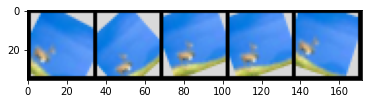

In [38]:
class AffineAugmenter(object):
    def __init__(self, min_scale=0.9, max_scale=1.1, max_offset=0.1):
        self._min_scale = min_scale
        self._max_scale = max_scale
        self._max_offset = max_offset
    
    def __call__(self, image):
        image = np.array(image)  # PIL -> Numpy.
        h, w, c = image.shape
        assert c == 3
        
        angle = random.random() * 90 - 45
        scale = self._min_scale + random.random() * (self._max_scale - self._min_scale)
        x_offset = random.randint(-int(self._max_offset * w), int(self._max_offset * w))
        y_offset = random.randint(-int(self._max_offset * h), int(self._max_offset * h))
        
        # Ваш код, который преобразует изображение используя угол angle,
        # масштаб scale и смещение (x_offset, y_offset). Фон предлагается закрасить серым цветом.
        
        # Начало вашего кода.
        
        transform = cv2.getRotationMatrix2D((w // 2, h // 2), angle, scale)
         # input -> Center of rotation, Angle of Rotation,  scaling factor which 
        
        transform[:, 2] += [x_offset, y_offset]
        
        new_image = cv2.warpAffine(image, transform, (w, h), borderValue=(128, 128, 128))
        
        # Конец вашего кода.
        
        return Image.fromarray(new_image)  # Numpy -> PIL.

seminar.show_augmenter_results(AffineAugmenter(), DATA_ROOT)

Пример:
<div style="clear:both;"></div>
<img style="float: left;" src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/aug-00-affine.jpg?raw=1" width="40%" height="40%">
<div style="clear:both;"></div>

Files already downloaded and verified
Trainset size: 5000


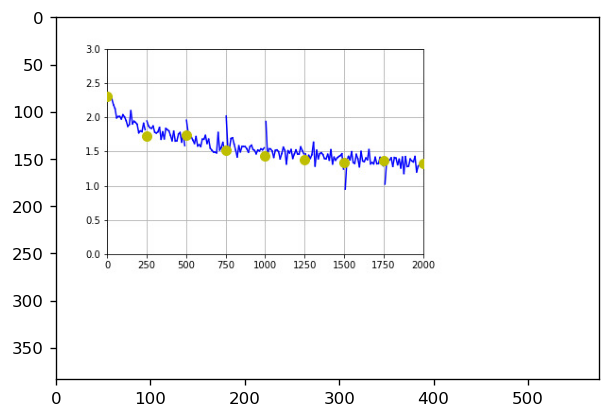

In [39]:
augmentation_transform = torchvision.transforms.Compose([
    AffineAugmenter(),
    transform
])
trainset_augmented_small = torch.utils.data.Subset(
    CIFAR10(DATA_ROOT, train=True, download=True, transform=augmentation_transform),
    trainset_small_indices)
print("Trainset size:", len(trainset_augmented_small))

# train_model(vgg_bn, make_loss, make_optimizer, trainset_augmented_small, testset,
#             lr_scheduler_fn=make_lr_scheduler,
#             num_epochs=10,
#             **TRAIN_KWARGS)
if True:
    seminar.show_image("resources/07-aug-affine.jpg")

Шпаргалка:
```(python)
cv2.resize(src, dsize[, dst[, fx[, fy[, interpolation]]]])
```

Files already downloaded and verified


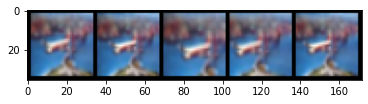

In [54]:
class CropAugmenter(object):
    def __init__(self, min_scale=0.8):
        self._min_scale = min_scale
    
    def __call__(self, image):
        image = np.array(image)  # PIL -> Numpy.
        h, w, c = image.shape
        assert c == 3
        scale = self._min_scale + random.random() * (1 - self._min_scale)
        new_w = int(scale * w)
        new_h = int(scale * h)
        x = random.randint(0, w - new_w)
        y = random.randint(0, h - new_h)
        
        # Ваш код, который создает изображение new_image с фрагментом изображения image, 
        # который задается смещением (x, y) и размером (new_w, new_h).
        
        # Начало вашего кода.
        
        new_image = cv2.resize(image[y:y + new_h, x:x+new_w], (w, h))
    
        # Конец вашего кода.
        
        return Image.fromarray(new_image)  # Numpy -> PIL.

seminar.show_augmenter_results(CropAugmenter(), DATA_ROOT)

Пример:
<div style="clear:both;"></div>
<img style="float: left;" src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/aug-01-crop.jpg?raw=1" width="40%" height="40%">
<div style="clear:both;"></div>

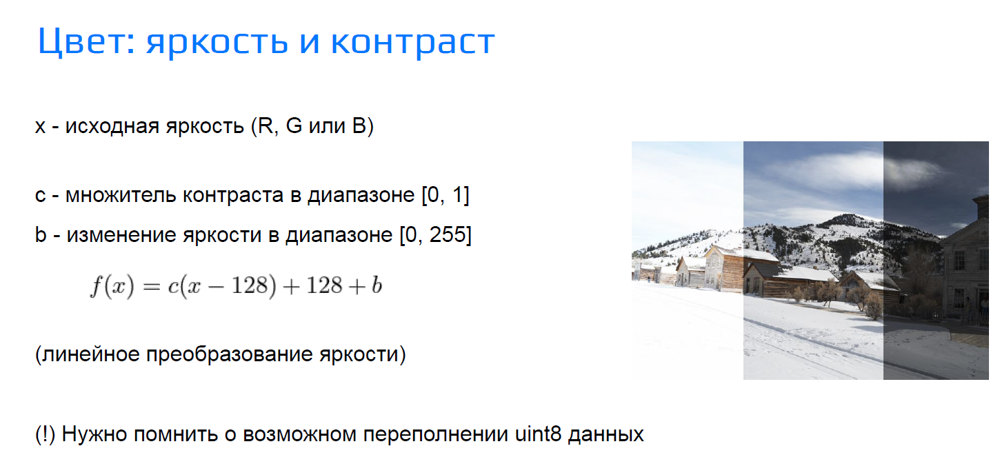2 * (random.random() - 0.5) * 0.3

Files already downloaded and verified


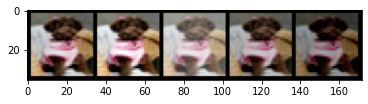

In [51]:
class BrightnessContrastAugmenter(object):
    def __init__(self, brightness=0.3, contrast=0.3):
        self._brightness = brightness
        self._contrast = contrast
    
    def __call__(self, image):
        image = np.array(image)  # PIL -> Numpy.
        h, w, c = image.shape
        assert c == 3
        brightness = 2 * (random.random() - 0.5) * self._brightness
        contrast = 1 + 2 * (random.random() - 0.5) * self._contrast
        
        # Ваш код, который применяет яркость brightness и контраст contrast.
        
        new_image = image.astype(np.float32)
        new_image = (new_image - 128) * contrast + 128
        new_image = new_image + brightness * 255
        new_image = np.clip(new_image, 0, 255).astype(np.uint8)
        
        # Конец вашего кода.
        
        assert new_image.dtype == np.uint8
        return Image.fromarray(new_image)  # Numpy -> PIL.
    
seminar.show_augmenter_results(BrightnessContrastAugmenter(), DATA_ROOT)

Пример:
<div style="clear:both;"></div>
<img style="float: left;" src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/aug-02-color.jpg?raw=1" width="40%" height="40%">
<div style="clear:both;"></div>

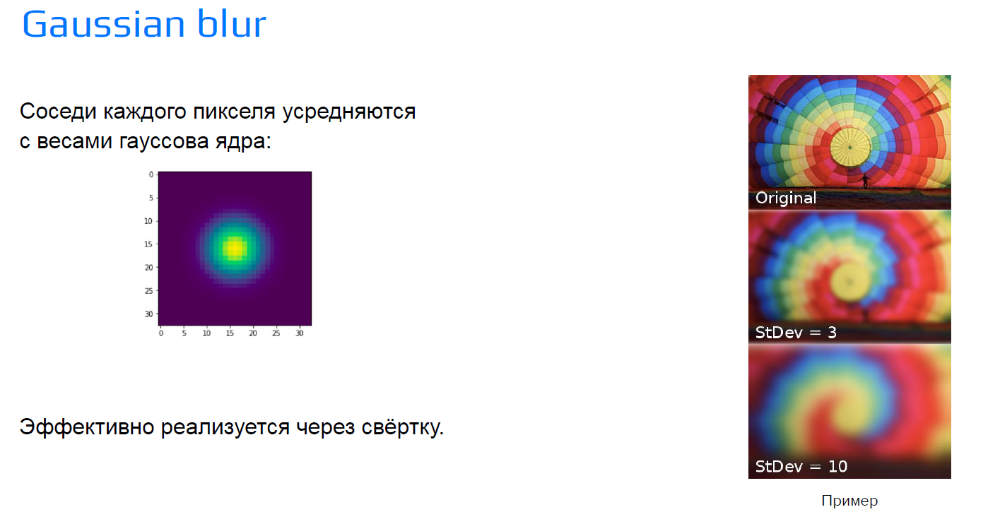

Шпаргалка:
    
```(python)
cv2.GaussianBlur(src, ksize, sigmaX[, dst[, sigmaY[, borderType]]])  # ksize: (w, h), sigmaX: число.
```

Files already downloaded and verified


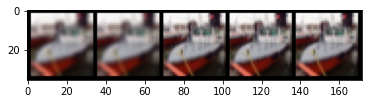

In [52]:
class BlurAugmenter(object):
    def __init__(self, max_kernel=5):
        self._max_kernel = max_kernel
    
    def __call__(self, image):
        kernel = random.randint(0, self._max_kernel // 2) * 2 + 1
        if kernel == 1:
            return image
        image = np.array(image)  # PIL -> Numpy.
        h, w, c = image.shape
        assert c == 3
        
        # Начало вашего кода.
        
        new_image = cv2.GaussianBlur(image, (kernel, kernel), kernel // 2)
        
        # Конец вашего кода.
        return Image.fromarray(new_image)  # Numpy -> PIL.
    
seminar.show_augmenter_results(BlurAugmenter(), DATA_ROOT)

Пример:
<div style="clear:both;"></div>
<img style="float: left;" src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/aug-03-blur.jpg?raw=1" width="40%" height="40%">
<div style="clear:both;"></div>

Files already downloaded and verified


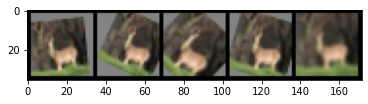

In [56]:
class RandomAugmentation(object):
    def __init__(self, *augmenters):
        self._augmenters = list(augmenters)
        
    def __call__(self, image):
        augmenter = random.choice(self._augmenters)
        return augmenter(image)
    
augmenter = RandomAugmentation(AffineAugmenter(),
                               CropAugmenter(),
                               BrightnessContrastAugmenter(),
                               BlurAugmenter())

seminar.show_augmenter_results(augmenter, DATA_ROOT)

Пример:
<div style="clear:both;"></div>
<img style="float: left;" src="https://github.com/lysukhin/MADE/blob/2022/computer_vision/seminar01_opencv_augment/resources/aug-04-random.jpg?raw=1" width="40%" height="40%">
<div style="clear:both;"></div>

Files already downloaded and verified
Trainset size: 5000


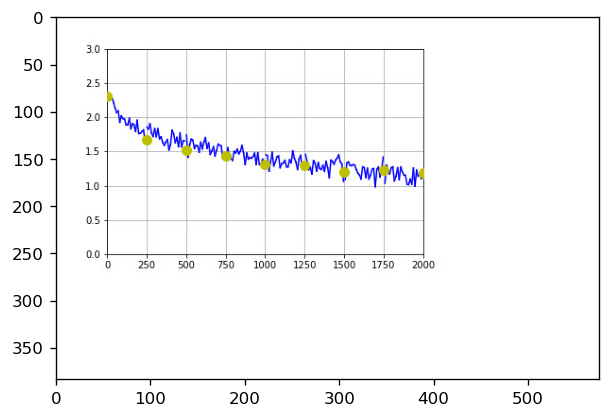

In [57]:
augmentation_transform = torchvision.transforms.Compose([
    augmenter,
    transform
])
trainset_augmented_small = torch.utils.data.Subset(
    CIFAR10(DATA_ROOT, train=True, download=True, transform=augmentation_transform),
    trainset_small_indices)
print("Trainset size:", len(trainset_augmented_small))

# train_model(vgg_bn, make_loss, make_optimizer, trainset_augmented_small, testset,
#             lr_scheduler_fn=make_lr_scheduler,
#             num_epochs=10,
#             **TRAIN_KWARGS)
if True:
    seminar.show_image("resources/08-aug-all.jpg")

# Albumentations

Большинство стандартных аугментаций уже реализовано

В torchvision классы трансформаций принимают изображение и возвращают изображение.

Классы трансформаций в albumentations принимают kwargs и возвращают словарь. За счёт этого albumentations может обрабатывать и изображения и метки.

albumentations не принимает PIL, нужно конверитровать в Numpy.

In [58]:
help(albumentations.GaussNoise)

Help on class GaussNoise in module albumentations.augmentations.transforms:

class GaussNoise(albumentations.core.transforms_interface.ImageOnlyTransform)
 |  GaussNoise(var_limit=(10.0, 50.0), mean=0, per_channel=True, always_apply=False, p=0.5)
 |  
 |  Apply gaussian noise to the input image.
 |  
 |  Args:
 |      var_limit ((float, float) or float): variance range for noise. If var_limit is a single float, the range
 |          will be (0, var_limit). Default: (10.0, 50.0).
 |      mean (float): mean of the noise. Default: 0
 |      per_channel (bool): if set to True, noise will be sampled for each channel independently.
 |          Otherwise, the noise will be sampled once for all channels. Default: True
 |      p (float): probability of applying the transform. Default: 0.5.
 |  
 |  Targets:
 |      image
 |  
 |  Image types:
 |      uint8, float32
 |  
 |  Method resolution order:
 |      GaussNoise
 |      albumentations.core.transforms_interface.ImageOnlyTransform
 |      al

Files already downloaded and verified


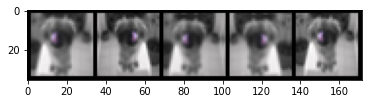

In [59]:
augmenter = albumentations.Compose([
    albumentations.ShiftScaleRotate(rotate_limit=0.25, p=0.7),
    albumentations.RandomBrightnessContrast(p=0.4),
    albumentations.RandomGamma(p=0.4),
    albumentations.Blur(blur_limit=2, p=0.1),
    albumentations.GaussNoise((10, 100), p=0.2),
    albumentations.HorizontalFlip(p=0.5)
])

seminar.show_augmenter_results(lambda image: augmenter(image=np.array(image))["image"], DATA_ROOT)

Files already downloaded and verified
Trainset size: 5000


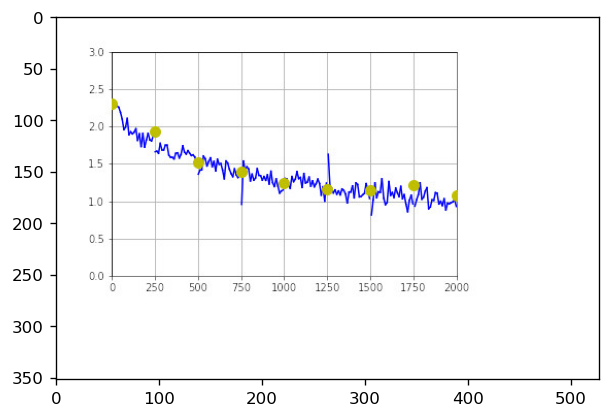

In [60]:
augmentation_transform = torchvision.transforms.Compose([
    lambda image: augmenter(image=np.array(image))["image"],
    transform
])

trainset_augmented_small = torch.utils.data.Subset(
    CIFAR10(DATA_ROOT, train=True, download=True, transform=augmentation_transform),
    trainset_small_indices)
print("Trainset size:", len(trainset_augmented_small))

#train_model(vgg_bn, make_loss, make_optimizer, trainset_augmented_small, testset,
#            lr_scheduler_fn=make_lr_scheduler,
#            num_epochs=10,
#            **TRAIN_KWARGS)
if True: 
    seminar.show_image("resources/09-aug-album.jpg")